In [1]:
from agents import ConsumerProducer, Influencer, ImperfectConsumerProducer
from content_market import ContentMarket
import numpy as np
from stats import TestStats

In [2]:
num_influencers = 1
num_consumer_producers = 50

production_rate = 1
external_production_rate = 1

topics = [[-1, 1]]
topics = np.array(topics)

In [3]:
content_market = ContentMarket(topics, production_rate, external_production_rate)

In [4]:
from util import exponential_decay, inverse_decay, tanh_decay

In [5]:
agent_colors = dict()

for i in range(num_consumer_producers):
    cons_func = lambda x: inverse_decay(x, 0.5, 2)
    prod_func = lambda x: inverse_decay(x, 0.5, 2)
    consumer_producer = ConsumerProducer(prod_func, cons_func, 50, 3, 1, init_following_rates_method='equal')
    #consumer_producer = ImperfectConsumerProducer(prod_func, cons_func, 10, 3, 1, init_following_rates_method='equal')
    content_market.add_agent(consumer_producer)

    color = np.random.rand(3,)
    agent_colors[consumer_producer.index] = color

for i in range(num_influencers):
    influencer = Influencer(100, 1, init_following_rates_method='equal')
    content_market.add_agent(influencer)

    color = np.random.rand(3,)
    agent_colors[influencer.index] = color

In [6]:
import matplotlib.pyplot as plt
import visualize

In [7]:
content_market.finalize(method='even')

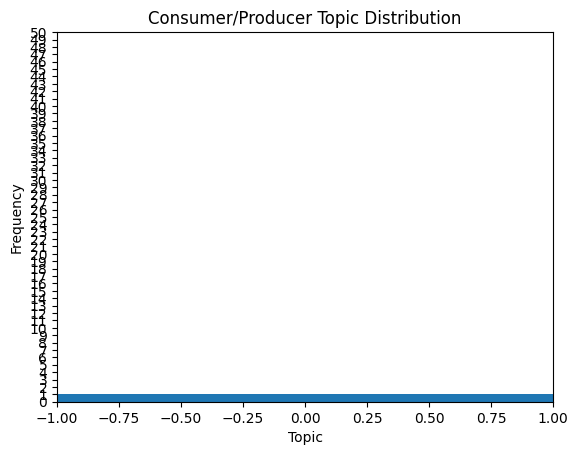

In [8]:
visualize.plot_topic_distribution_histogram("Consumer/Producer Topic Distribution", content_market.consumers, -1, 1)

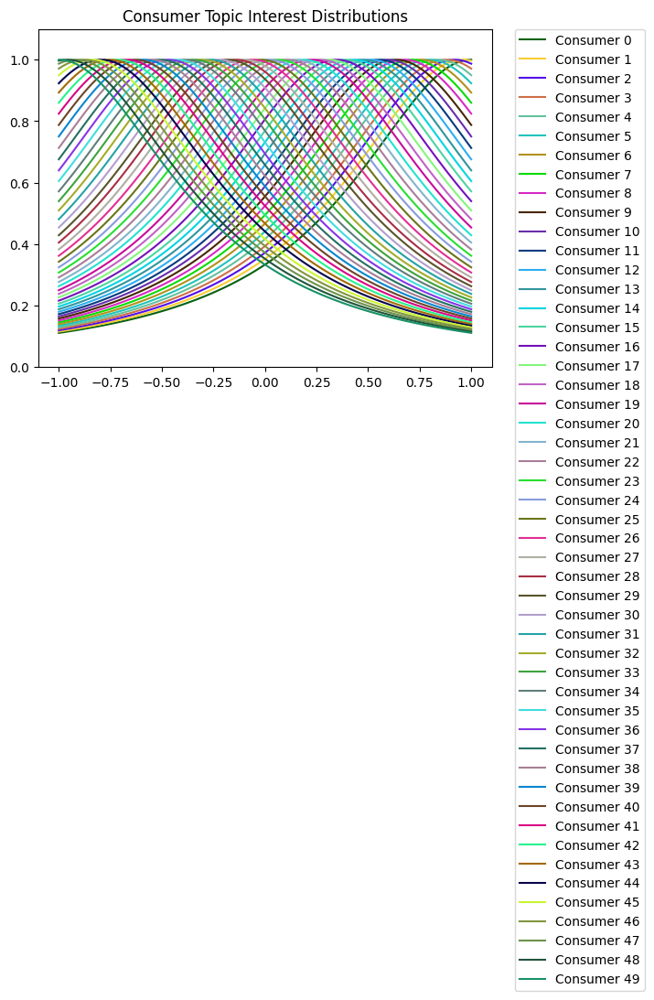

In [9]:
visualize.plot_consumer_topic_interest_distributions("Consumer Topic Interest Distributions", content_market.consumers, -1, 1, agent_colors)

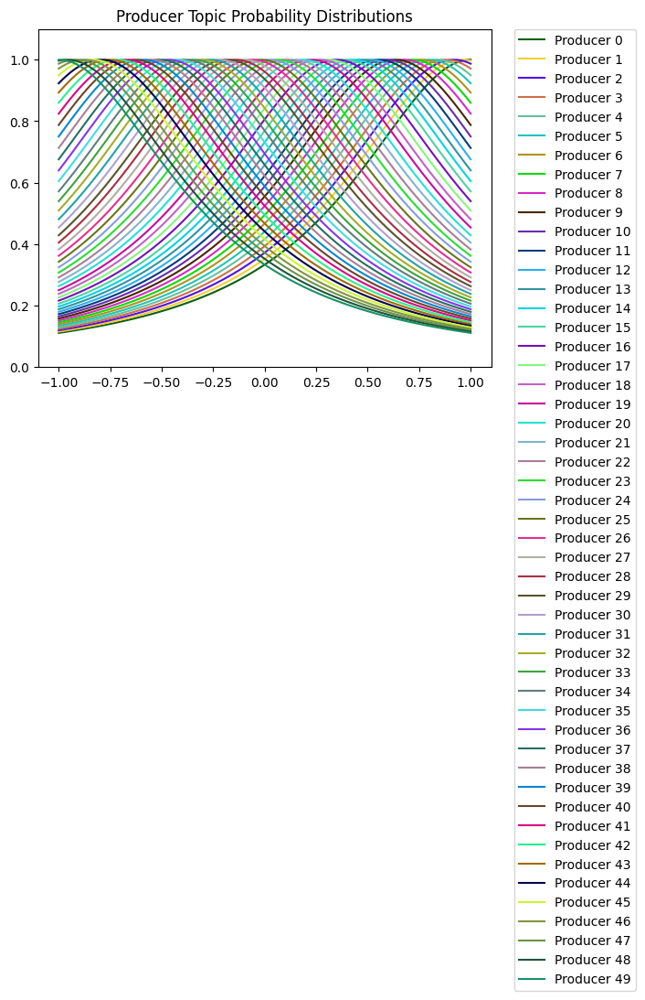

In [10]:
visualize.plot_producer_topic_probability_distributions("Producer Topic Probability Distributions", content_market.producers, -1, 1, agent_colors)

In [11]:
stats: TestStats = content_market.optimize(100)

Optimizing consumer 0


Optimizing consumer 1
Optimizing consumer 2
Optimizing consumer 3
Optimizing consumer 4
Optimizing consumer 5
Optimizing consumer 6
Optimizing consumer 7
Optimizing consumer 8
Optimizing consumer 9
Optimizing consumer 10
Optimizing consumer 11
Optimizing consumer 12
Optimizing consumer 13
Optimizing consumer 14
Optimizing consumer 15
Optimizing consumer 16
Optimizing consumer 17
Optimizing consumer 18
Optimizing consumer 19
Optimizing consumer 20
Optimizing consumer 21
Optimizing consumer 22
Optimizing consumer 23
Optimizing consumer 24
Optimizing consumer 25
Optimizing consumer 26
Optimizing consumer 27
Optimizing consumer 28
Optimizing consumer 29
Optimizing consumer 30
Optimizing consumer 31
Optimizing consumer 32
Optimizing consumer 33
Optimizing consumer 34
Optimizing consumer 35
Optimizing consumer 36
Optimizing consumer 37
Optimizing consumer 38
Optimizing consumer 39
Optimizing consumer 40
Optimizing consumer 41
Optimizing consumer 42
Optimizing consumer 43
Optimizing consumer 

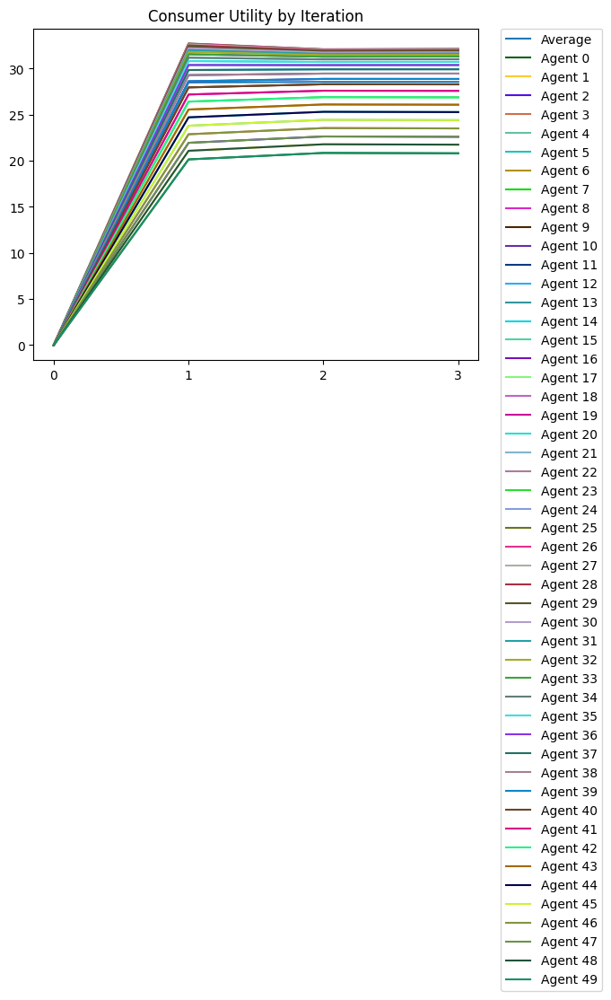

In [12]:
visualize.plot_agent_utility_by_iteration("Consumer Utility by Iteration", content_market.consumers, agent_colors, stats.consumer_stats, stats.average_consumer_utility)

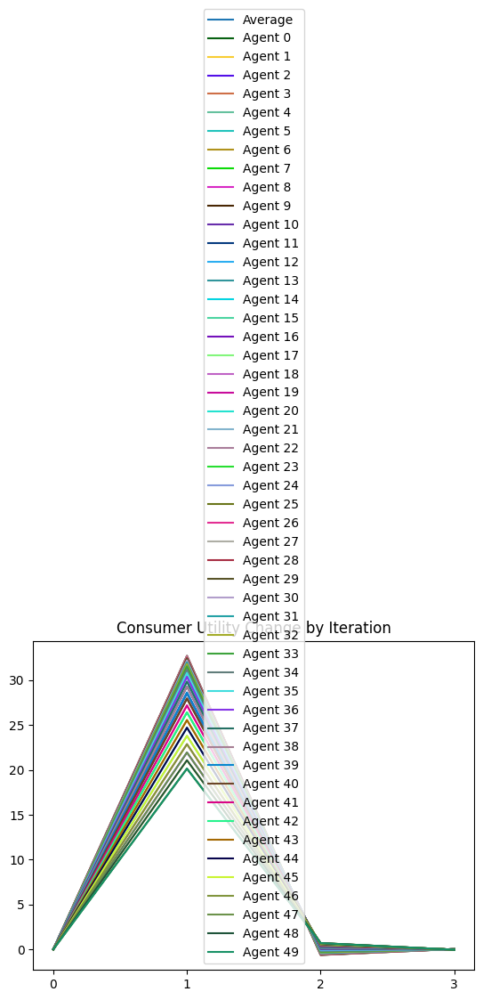

In [13]:
visualize.plot_agent_utility_change_by_iteration("Consumer Utility Change by Iteration", content_market.consumers, agent_colors, stats.consumer_stats, stats.average_consumer_utility_change)

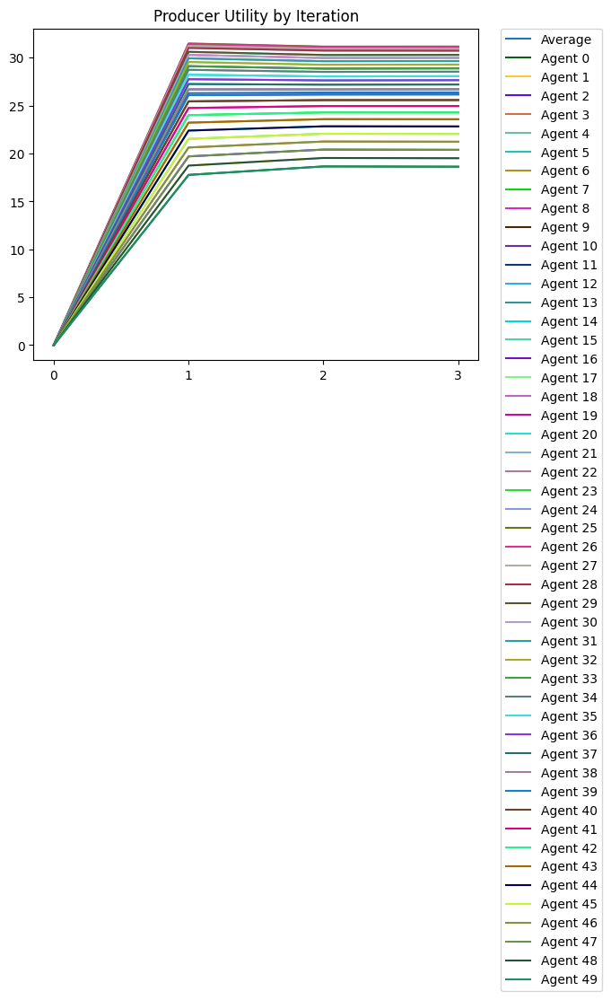

In [14]:
visualize.plot_agent_utility_by_iteration("Producer Utility by Iteration", content_market.producers, agent_colors, stats.producer_stats, stats.average_producer_utility)

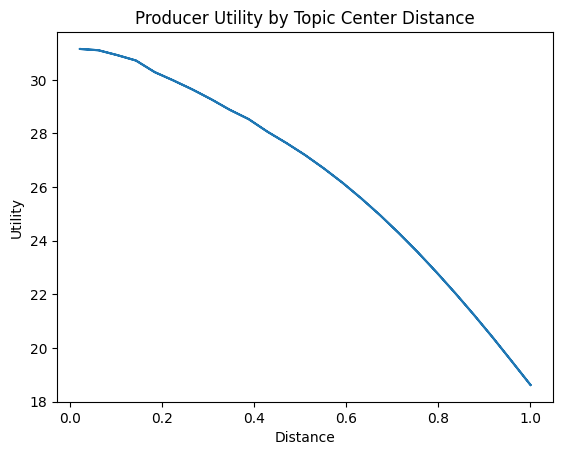

In [15]:
plt.figure()
plt.title('Producer Utility by Topic Center Distance')
topic_center = [(content_market.topics_bounds[i][0] + content_market.topics_bounds[i][1]) / 2 for i in range(len(content_market.topics_bounds))]
distances = []
utilities = []
for producer in content_market.producers:
    main_interest = producer.main_interest
    distance = np.linalg.norm(main_interest - topic_center)
    distances.append(distance)
    utilities.append(stats.producer_stats[producer.index].utilities[-1])
plt.plot(distances, utilities)
plt.xlabel('Distance')
plt.ylabel('Utility')
plt.show()

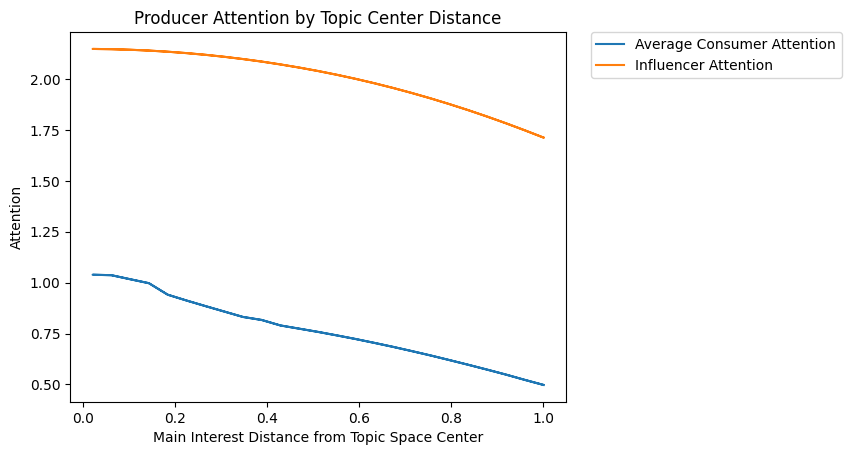

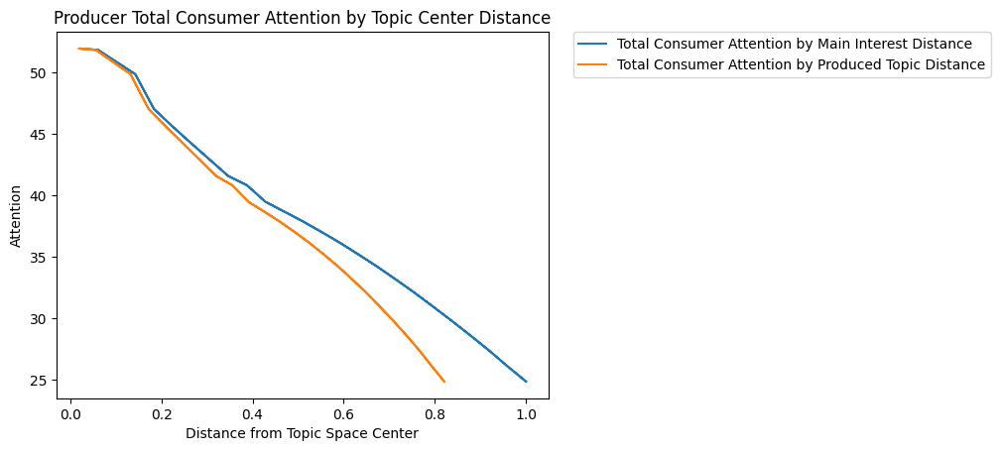

In [47]:

topic_center = [(content_market.topics_bounds[i][0] + content_market.topics_bounds[i][1]) / 2 for i in range(len(content_market.topics_bounds))]
distances = []
topics_produced_distances = []
avg_consumer_attentions = []
total_consumer_attentions = []
influencer_attentions = []
for producer in content_market.producers:
    main_interest = producer.main_interest
    distance = np.linalg.norm(main_interest - topic_center)
    distances.append(distance)
    topic_produced = stats.producer_stats[producer.index].topics[-1]
    topics_produced_distances.append(np.linalg.norm(topic_produced - topic_center))
    influencer_attentions.append(stats.influencer_stats[content_market.influencers[0].index].following_rates[-1][producer.index])
    consumer_attn = 0
    for consumer in content_market.consumers:
        consumer_attn += stats.consumer_stats[consumer.index].following_rates[-1][producer.index]
    avg_consumer_attentions.append(consumer_attn / len(content_market.consumers))
    total_consumer_attentions.append(consumer_attn)
plt.figure()
plt.title('Producer Attention by Topic Center Distance')
plt.plot(distances, avg_consumer_attentions, label='Average Consumer Attention')
plt.plot(distances, influencer_attentions, label='Influencer Attention')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.xlabel('Main Interest Distance from Topic Space Center')
plt.ylabel('Attention')
plt.show()

plt.figure()
plt.title('Producer Total Consumer Attention by Topic Center Distance')
plt.plot(distances, total_consumer_attentions, label='Total Consumer Attention by Main Interest Distance')
plt.plot(topics_produced_distances, total_consumer_attentions, label='Total Consumer Attention by Produced Topic Distance')
plt.xlabel('Distance from Topic Space Center')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.ylabel('Attention')
plt.show()

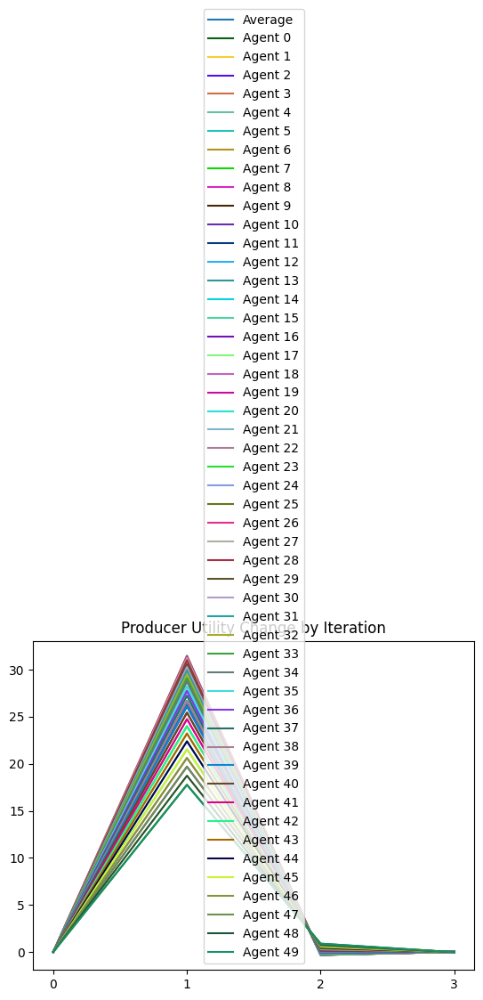

In [17]:
visualize.plot_agent_utility_change_by_iteration("Producer Utility Change by Iteration", content_market.producers, agent_colors, stats.producer_stats, stats.average_producer_utility_change)

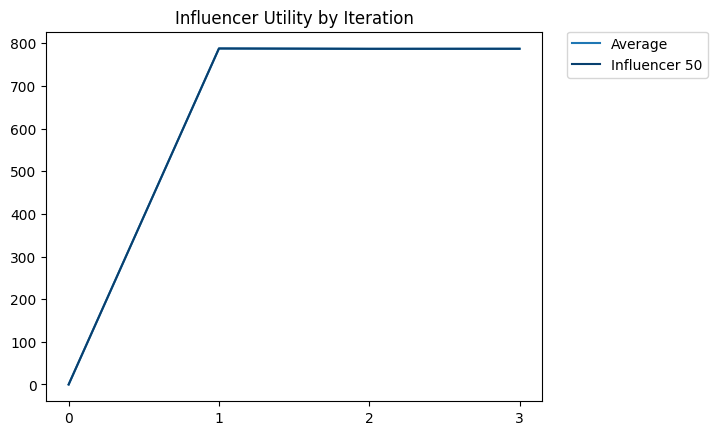

In [18]:
visualize.plot_agent_utility_by_iteration("Influencer Utility by Iteration", content_market.influencers, agent_colors, stats.influencer_stats, stats.average_influencer_utility)

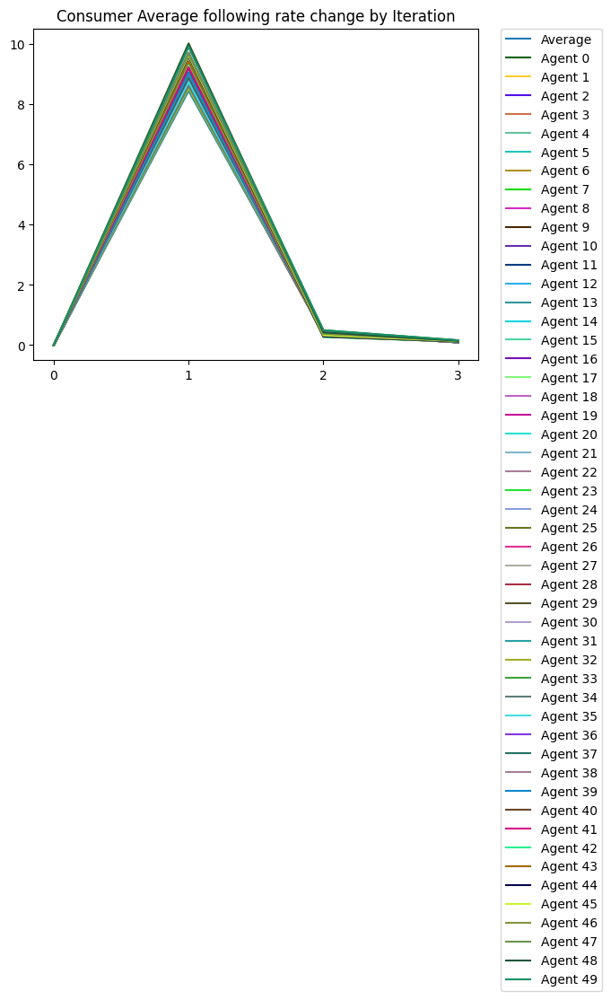

In [19]:
visualize.plot_following_rate_change_by_iteration("Consumer Average following rate change by Iteration", content_market.consumers, agent_colors, stats.consumer_stats, stats.average_consumer_rate_change)

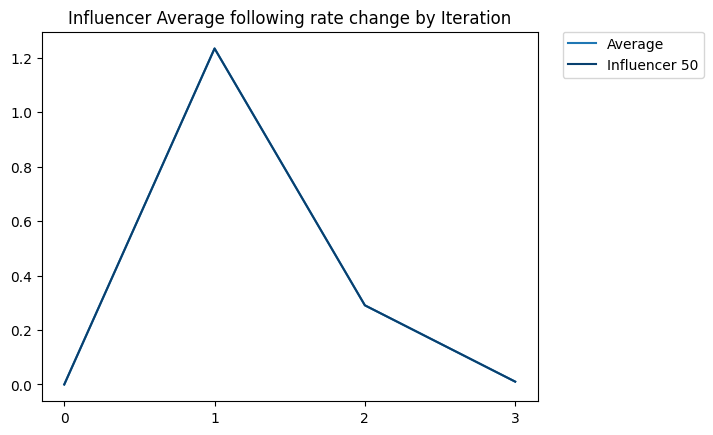

In [20]:
visualize.plot_following_rate_change_by_iteration("Influencer Average following rate change by Iteration", content_market.influencers, agent_colors, stats.influencer_stats, stats.average_influencer_rate_change)

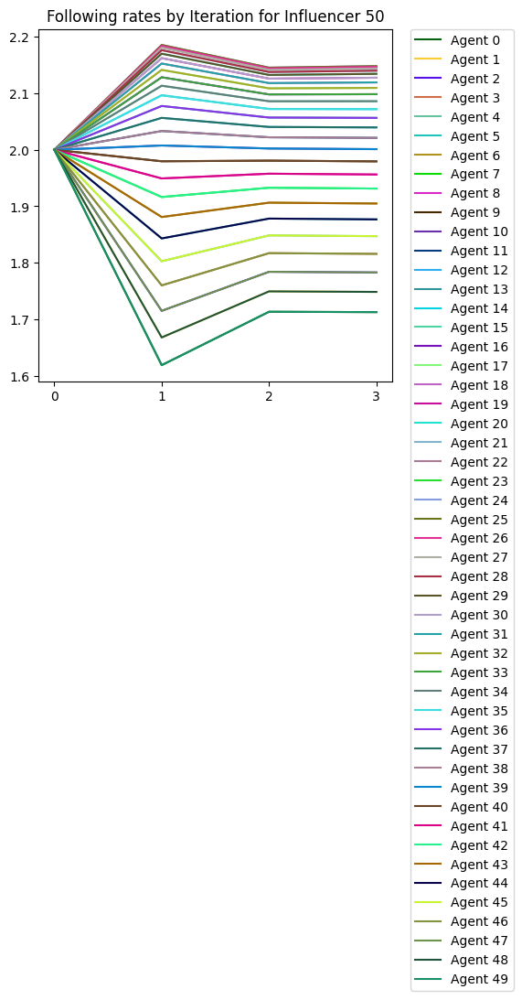

In [21]:
visualize.plot_following_rates_by_iteration(content_market.influencers, content_market.producers, agent_colors, stats.influencer_stats)

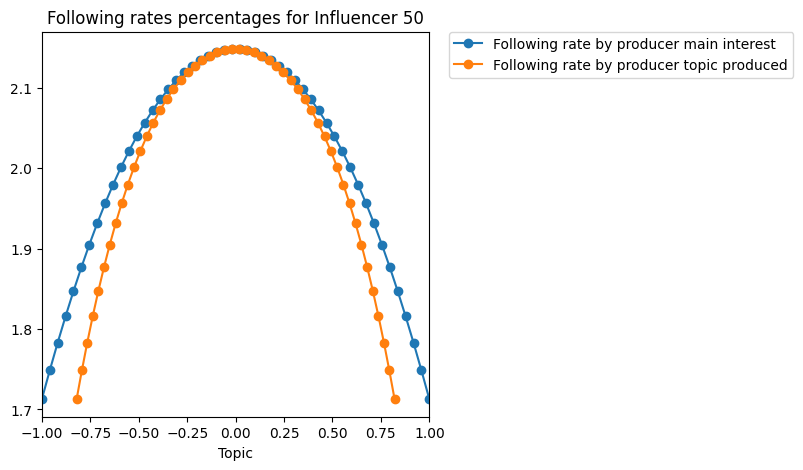

In [22]:
visualize.plot_agent_following_rates(content_market.influencers, stats.influencer_stats, agent_colors)

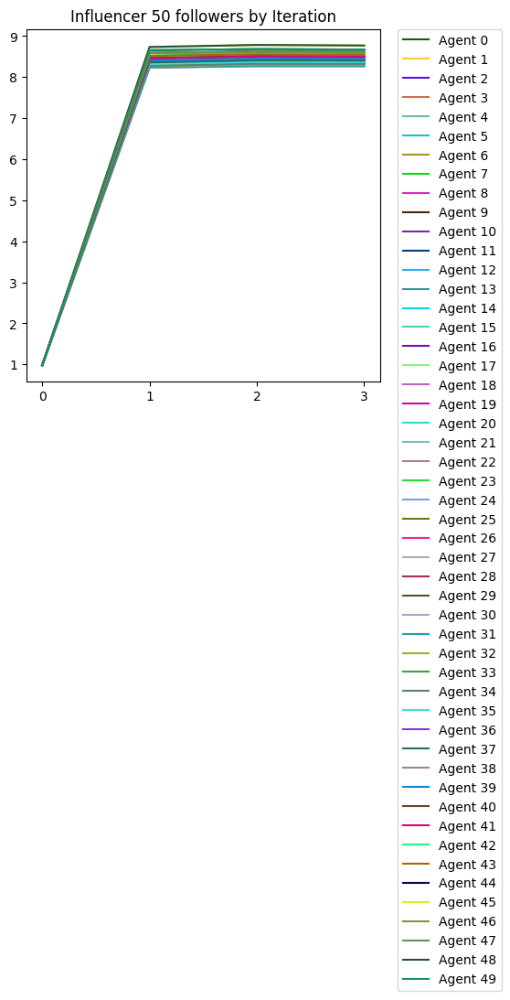

In [23]:
visualize.plot_follows_by_iteration(content_market.influencers, content_market.consumers, agent_colors, stats.consumer_stats)

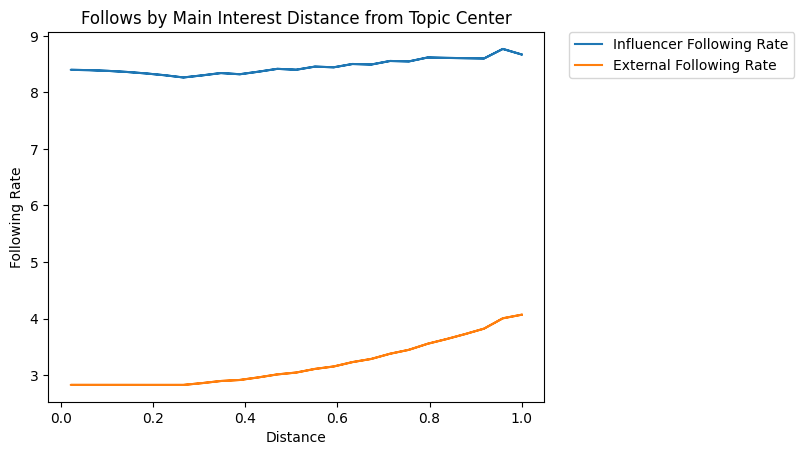

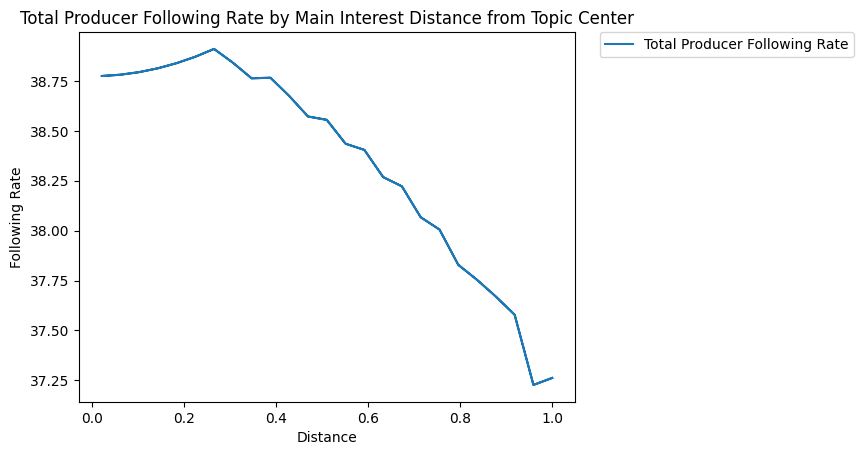

In [50]:
plt.figure()
plt.title('Follows by Main Interest Distance from Topic Center')
topic_center = [(content_market.topics_bounds[i][0] + content_market.topics_bounds[i][1]) / 2 for i in range(len(content_market.topics_bounds))]
distances = []
influencer_rates = []
closest_producer_rates = []
total_producer_rates = []
external_rates = []
for consumer in content_market.consumers:
    main_interest = consumer.main_interest
    distance = np.linalg.norm(main_interest - topic_center)
    #distance = main_interest[0] - topic_center[0]
    distances.append(distance)
    influencer_rates.append(stats.consumer_stats[consumer.index].following_rates[-1][content_market.influencers[0].index])
    external_rates.append(stats.consumer_stats[consumer.index].following_rates[-1][-1])

    closest_producer = sorted(content_market.producers, key=lambda x: np.linalg.norm(main_interest - x.main_interest))[0]
    closest_producer_rates.append(stats.consumer_stats[consumer.index].following_rates[-1][closest_producer.index])

    total_producer_rates.append(sum(stats.consumer_stats[consumer.index].following_rates[-1][:-2]))
plt.plot(distances, influencer_rates, label='Influencer Following Rate')
plt.plot(distances, external_rates, label='External Following Rate')
#plt.plot(distances, closest_producer_rates, label='Closest Producer Following Rate')

plt.xlabel('Distance')
plt.ylabel('Following Rate')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.show()

plt.figure()
plt.title('Total Producer Following Rate by Main Interest Distance from Topic Center')
plt.plot(distances, total_producer_rates, label='Total Producer Following Rate')
plt.xlabel('Distance')
plt.ylabel('Following Rate')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.show()

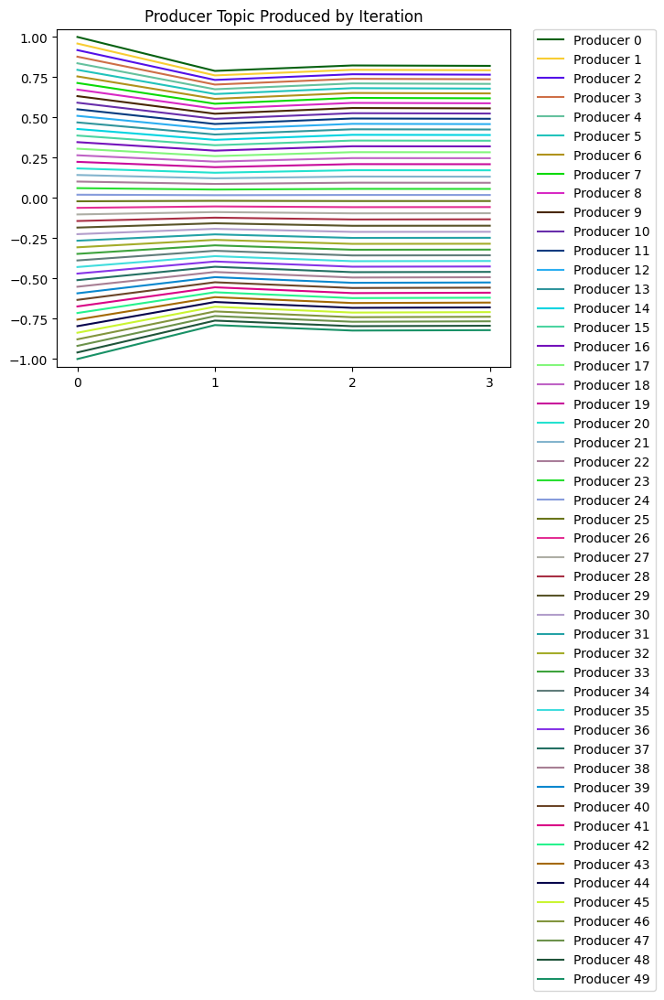

In [25]:
visualize.plot_producer_topic_produced_by_iteration("Producer Topic Produced by Iteration", content_market.producers, content_market.consumers, agent_colors, stats.producer_stats, False)

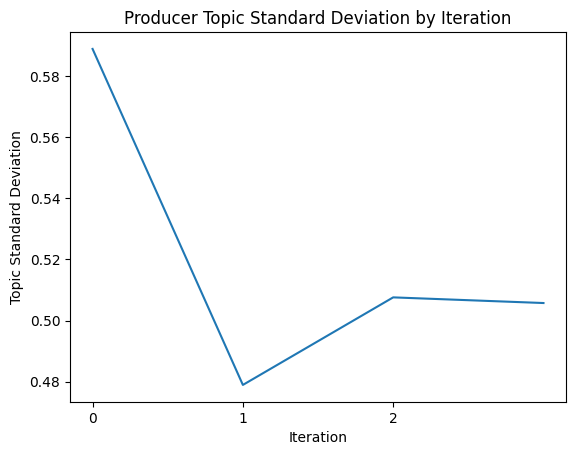

In [26]:
visualize.plot_value_by_iteration("Producer Topic Standard Deviation by Iteration", stats, "producer_topic_standard_deviation", "Topic Standard Deviation")

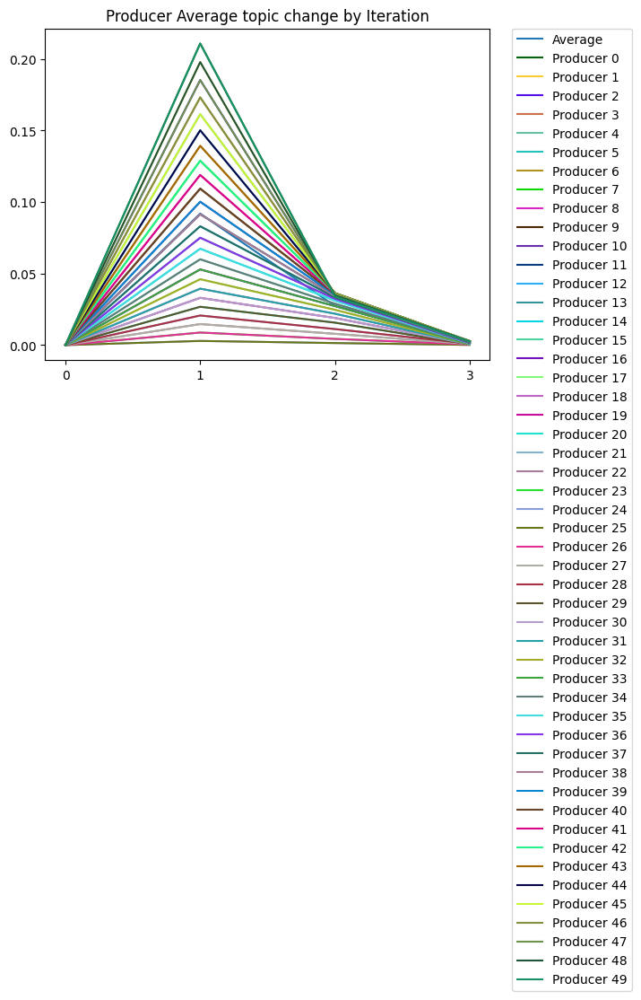

In [27]:
visualize.plot_producer_topic_change_by_iteration("Producer Average topic change by Iteration", content_market.producers, agent_colors, stats.producer_stats, stats.average_producer_topic_change)

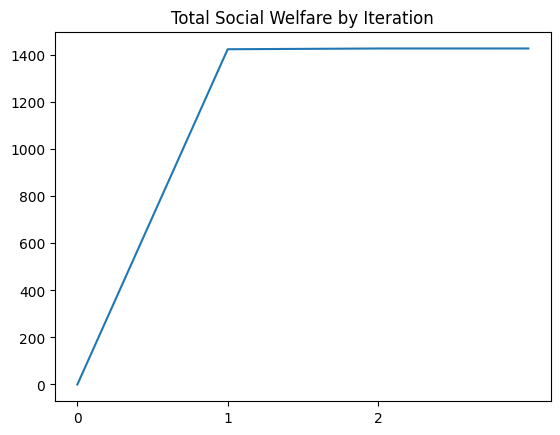

In [28]:
visualize.plot_total_social_welfare_by_iteration("Total Social Welfare by Iteration", stats)

In [29]:
import importlib
importlib.reload(visualize)

<module 'visualize' from '/Users/gabeguralnick/git/content-market-experiment/visualize.py'>

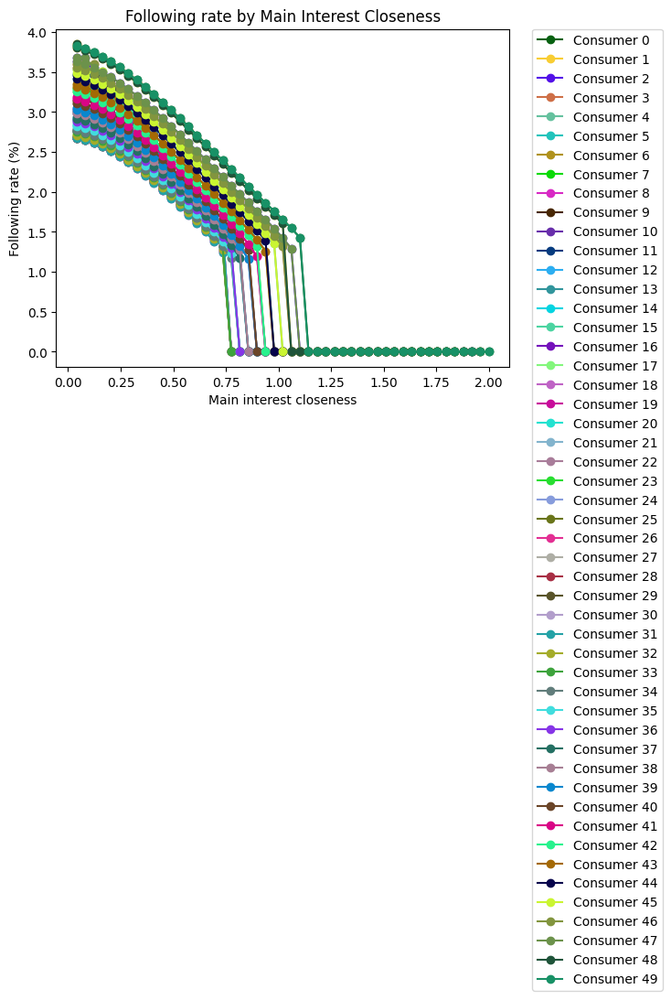

In [30]:
visualize.plot_following_rate_by_main_interest_closeness("Following rate by Main Interest Closeness", content_market.consumers, content_market.producers, agent_colors, stats.consumer_stats)

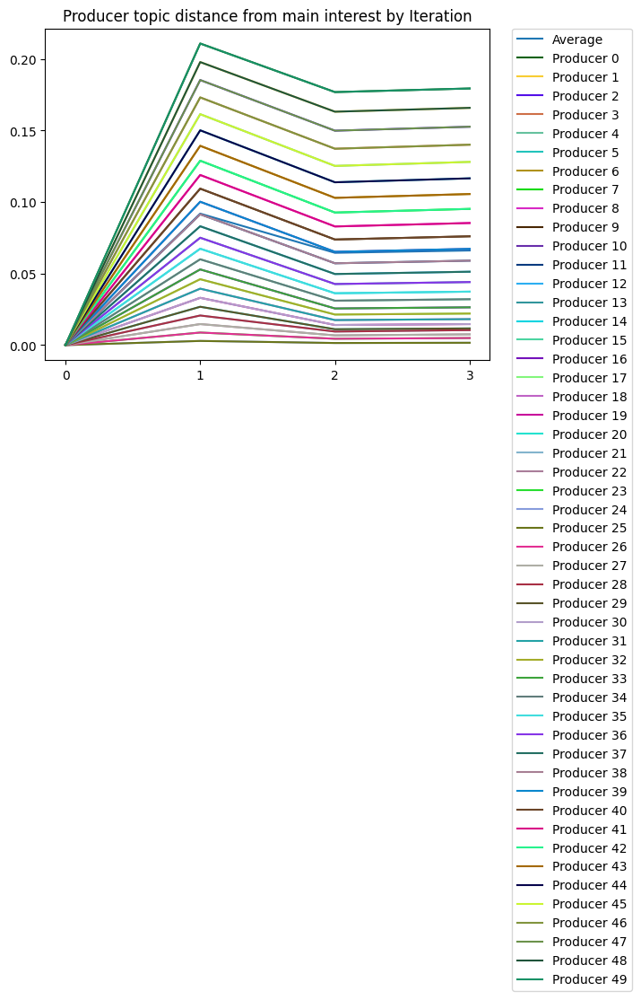

In [31]:
visualize.plot_producer_topic_distance_from_main_interest_by_iteration("Producer topic distance from main interest by Iteration", content_market.producers, agent_colors, stats.producer_stats, stats.average_producer_topic_distance_from_main_interest)

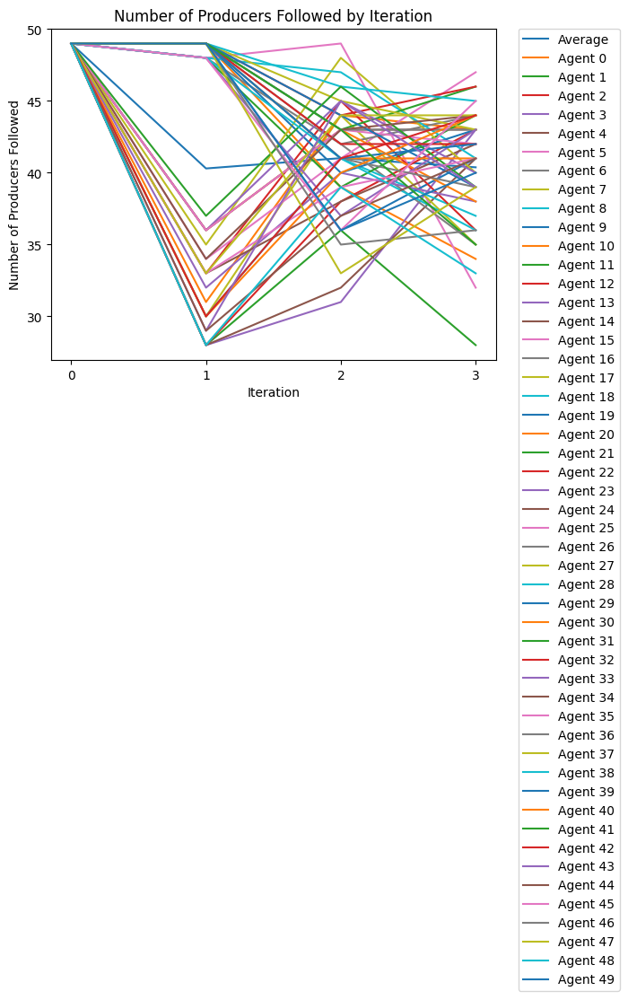

In [32]:
visualize.plot_value_by_agent_by_iteration("Number of Producers Followed by Iteration", stats.consumer_stats, "num_producers_followed", "Number of Producers Followed", stats.average_consumer_num_producers_followed)

[[ 1.         -0.47323934]
 [-0.47323934  1.        ]]


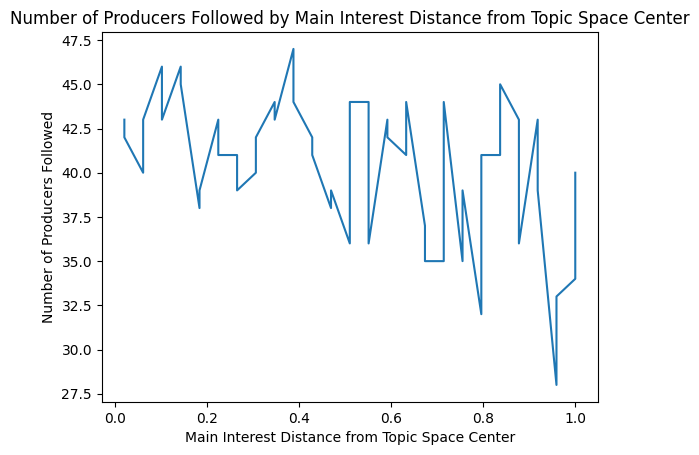

In [53]:
num_prods_by_main_interest_magnitude = []
topic_center = np.array([(bound[0] + bound[1]) / 2 for bound in content_market.topics_bounds])

for consumer in content_market.consumers:
    main_interest_mag = np.linalg.norm(consumer.main_interest - topic_center)
    num_prods_by_main_interest_magnitude.append((main_interest_mag, stats.consumer_stats[consumer.index].num_producers_followed[-1]))

num_prods_by_main_interest_magnitude.sort(key=lambda x: x[0])
print(np.corrcoef([x[0] for x in num_prods_by_main_interest_magnitude], [x[1] for x in num_prods_by_main_interest_magnitude]))
plt.figure()
plt.plot([x[0] for x in num_prods_by_main_interest_magnitude], [x[1] for x in num_prods_by_main_interest_magnitude])
plt.xlabel("Main Interest Distance from Topic Space Center")
plt.ylabel("Number of Producers Followed")
plt.title("Number of Producers Followed by Main Interest Distance from Topic Space Center")
plt.show()

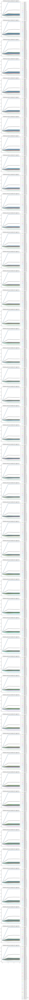

In [34]:
visualize.plot_following_rates_by_iteration(content_market.consumers, sorted(list(set(content_market.producers + content_market.influencers)), key=lambda x: x.index), agent_colors, stats.consumer_stats)

In [35]:
import importlib
importlib.reload(visualize)

<module 'visualize' from '/Users/gabeguralnick/git/content-market-experiment/visualize.py'>

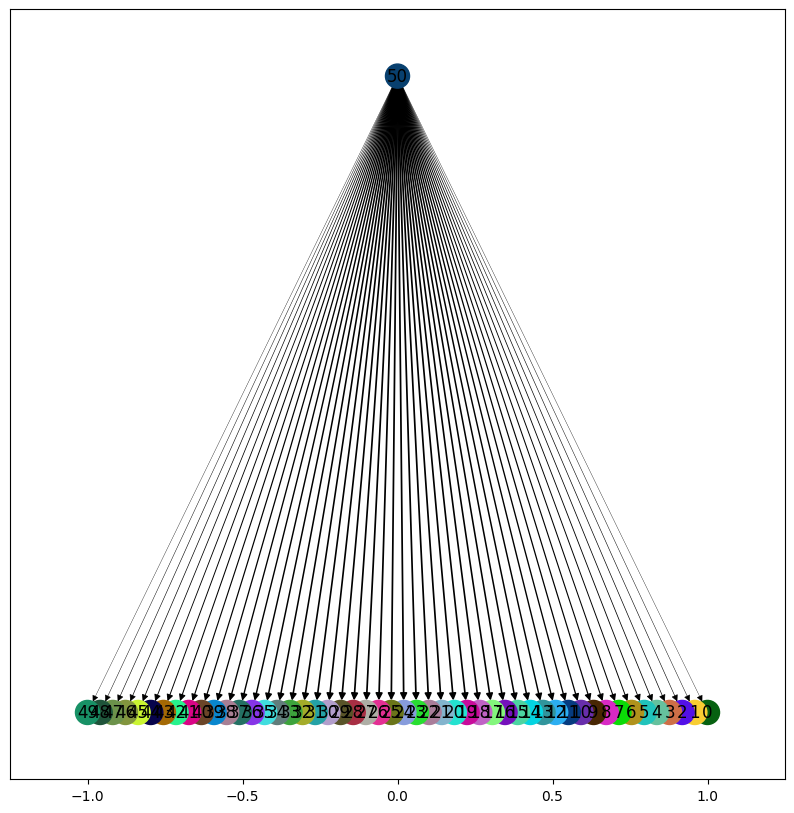

In [36]:
visualize.visualize_influencer(content_market, stats.influencer_stats[content_market.influencers[0].index], agent_colors)

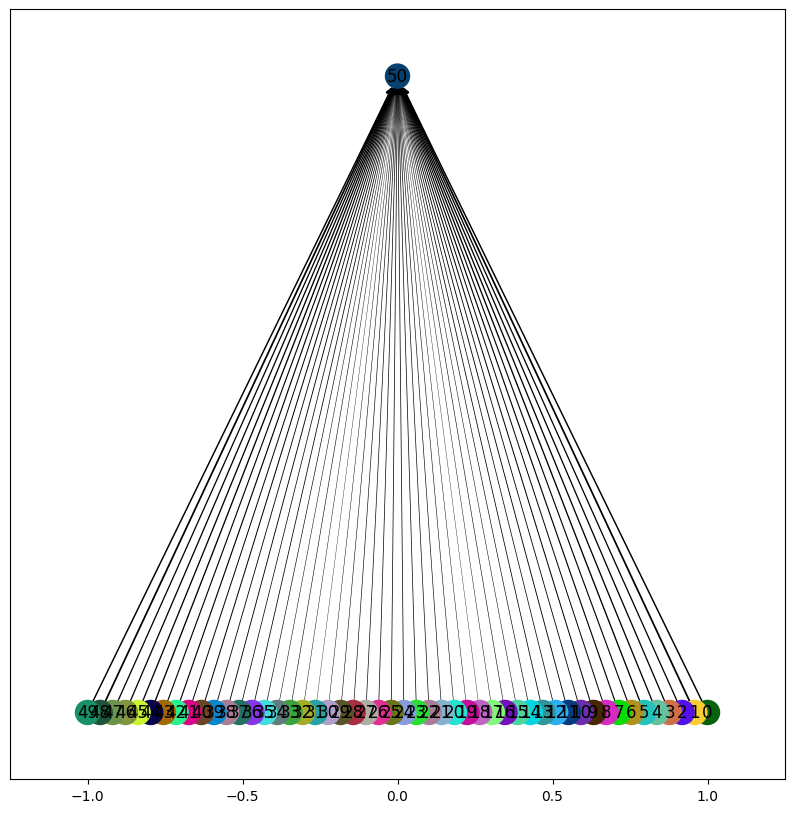

In [37]:
visualize.visualize_influencer_followers(content_market, stats.consumer_stats, agent_colors)

{0: (1.0, 0), 1: (0.9591836734693877, 0), 2: (0.9183673469387754, 0), 3: (0.8775510204081631, 0), 4: (0.8367346938775508, 0), 5: (0.7959183673469385, 0), 6: (0.7551020408163265, 0), 7: (0.7142857142857142, 0), 8: (0.6734693877551019, 0), 9: (0.6326530612244896, 0), 10: (0.5918367346938773, 0), 11: (0.5510204081632653, 0), 12: (0.510204081632653, 0), 13: (0.46938775510204067, 0), 14: (0.4285714285714284, 0), 15: (0.3877551020408163, 0), 16: (0.346938775510204, 0), 17: (0.30612244897959173, 0), 18: (0.26530612244897944, 0), 19: (0.22448979591836715, 0), 20: (0.18367346938775508, 0), 21: (0.1428571428571428, 0), 22: (0.1020408163265305, 0), 23: (0.06122448979591821, 0), 24: (0.020408163265306145, 0), 25: (-0.020408163265306145, 0), 26: (-0.061224489795918435, 0), 27: (-0.10204081632653073, 0), 28: (-0.1428571428571429, 0), 29: (-0.1836734693877552, 0), 30: (-0.22448979591836737, 0), 31: (-0.26530612244897966, 0), 32: (-0.30612244897959184, 0), 33: (-0.34693877551020413, 0), 34: (-0.387755

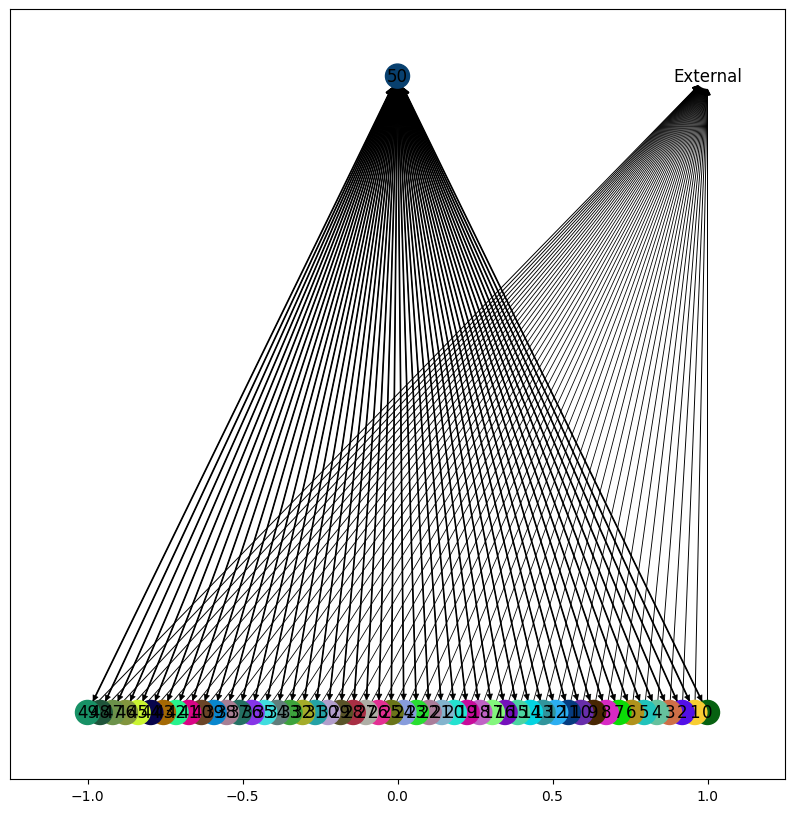

In [38]:
visualize.visualize_market(content_market, stats, agent_colors)

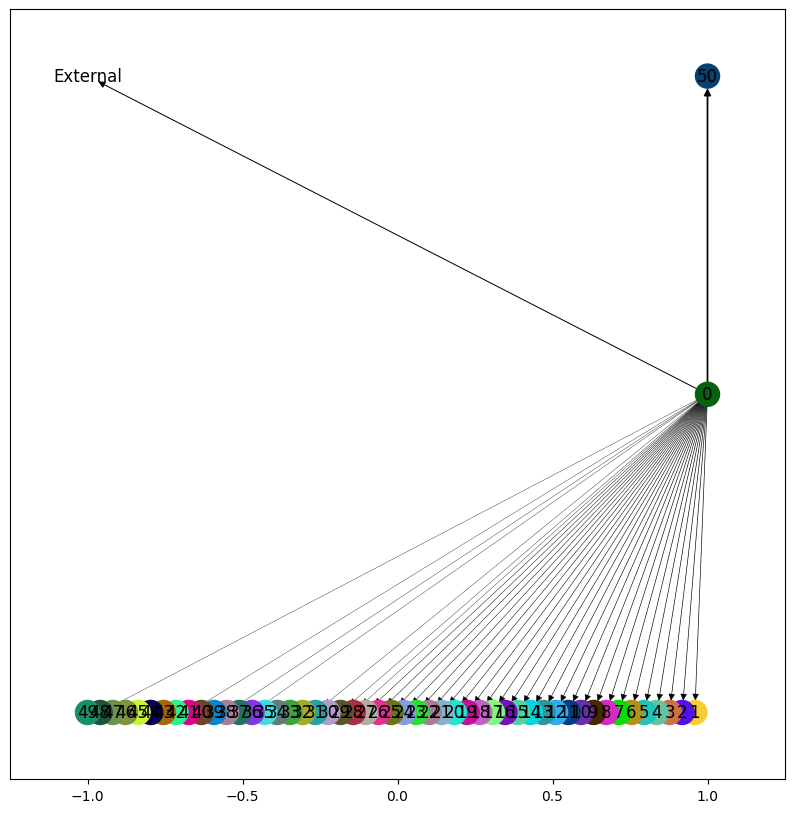

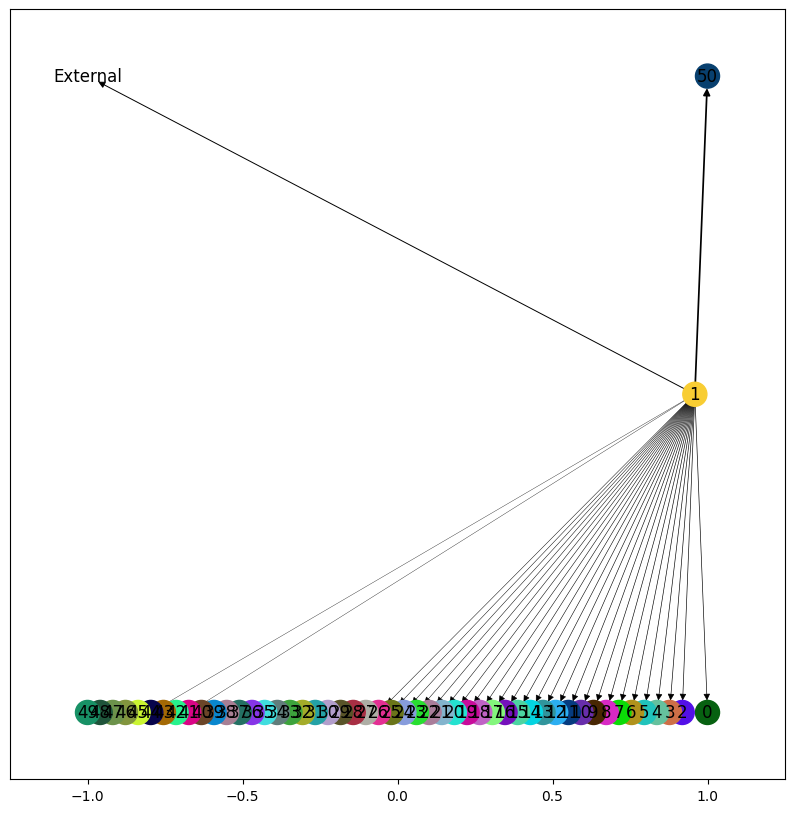

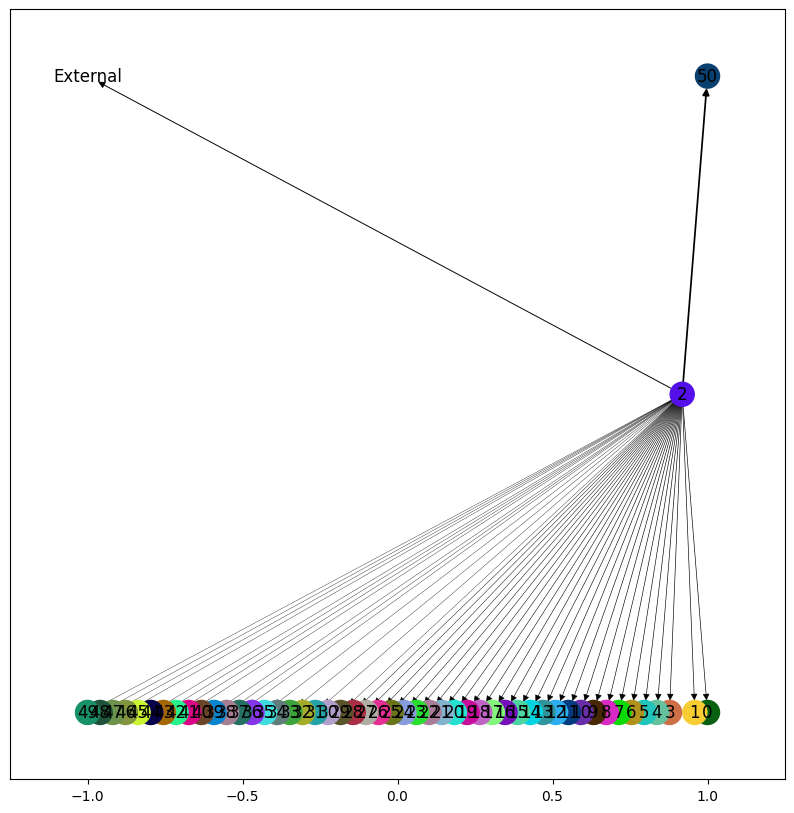

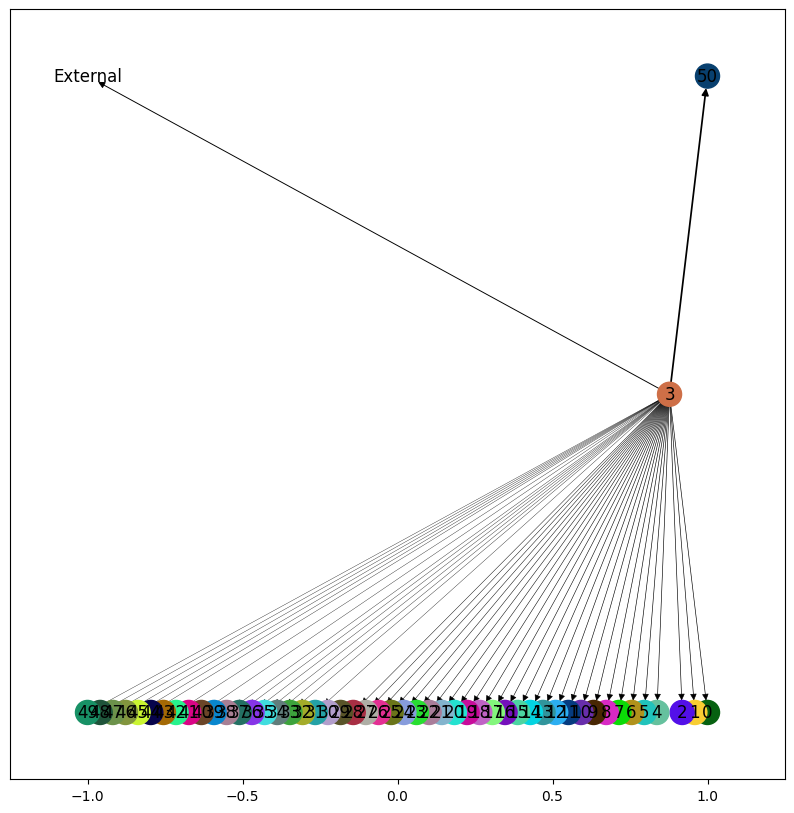

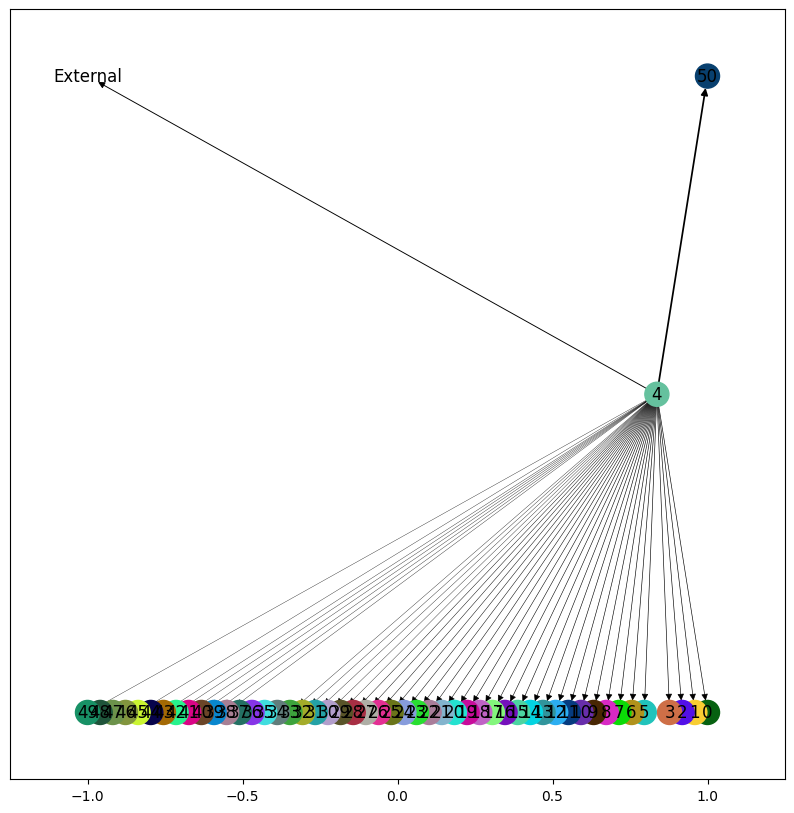

...

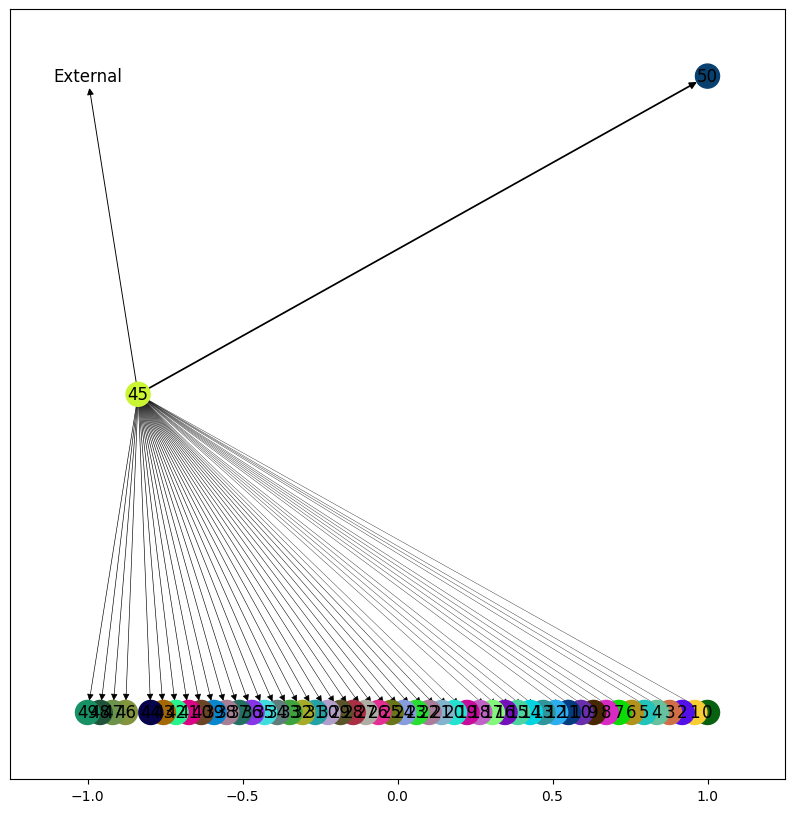

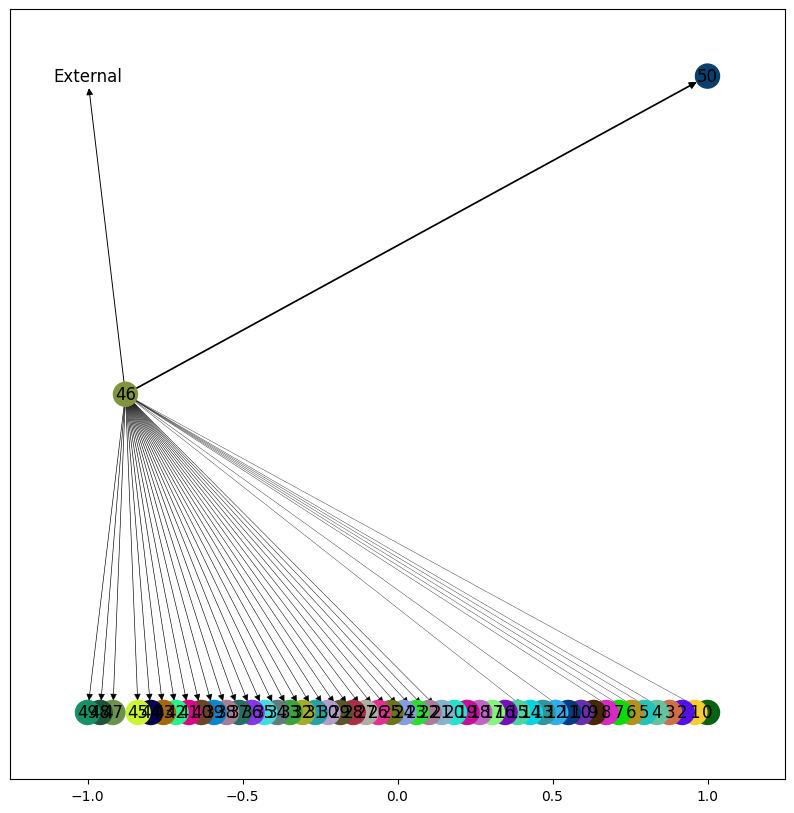

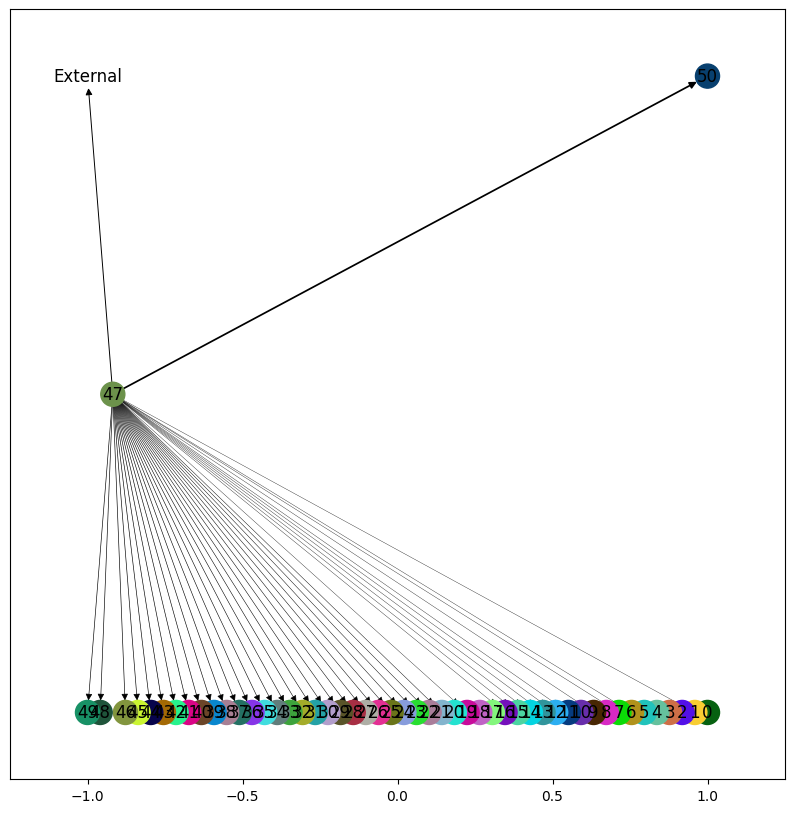

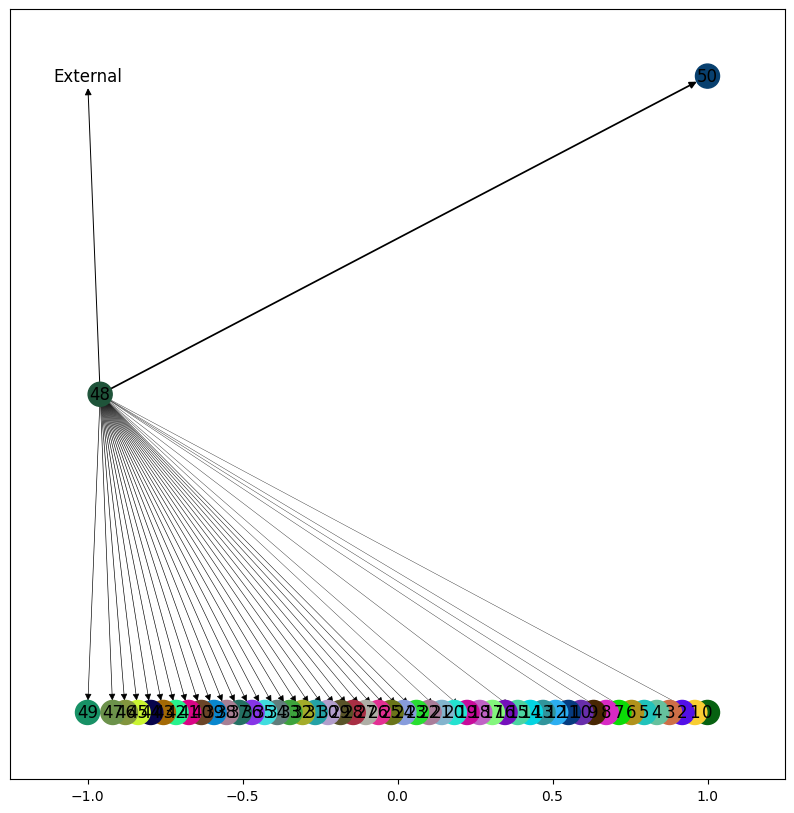

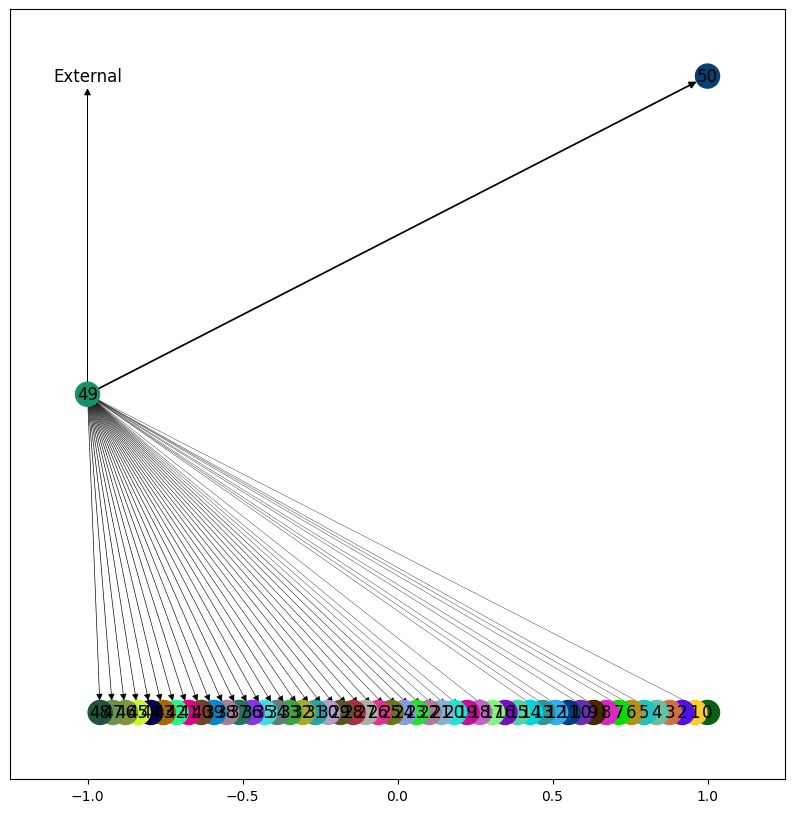

In [39]:
for consumer in content_market.consumers:
    visualize.visualize_consumer(content_market, stats.consumer_stats[consumer.index], agent_colors)

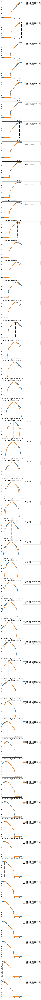

In [40]:
visualize.plot_agent_following_rates(content_market.consumers, stats.consumer_stats, agent_colors)

In [41]:
stats.to_dict()

{'num_iterations': 3,
 'total_consumer_utility': [0,
  1424.544782112908,
  1427.7351102546177,
  1427.794073057916],
 'total_producer_utility': [0,
  1314.9769602668835,
  1318.4300305213314,
  1318.5230489922828],
 'total_influencer_utility': [0,
  787.9269527054947,
  787.1310839076854,
  787.2527946611536],
 'total_social_welfare': [0,
  1424.544782112908,
  1427.7351102546177,
  1427.794073057916],
 'average_consumer_rate_change': [0,
  9.021255596789963,
  0.3663865312736552,
  0.11108525585062455],
 'average_producer_topic_change': [0,
  0.09189903556150117,
  0.02740463748407235,
  0.0016415889196732913],
 'average_influencer_rate_change': [0,
  1.2342034851772066,
  0.2907795404571792,
  0.010434552034183562],
 'average_consumer_utility_change': [0,
  28.490895642258153,
  0.06380656283421089,
  0.00117925606596593],
 'average_producer_utility_change': [0,
  26.29953920533766,
  0.06906140508897451,
  0.0018603694190205999],
 'average_influencer_utility_change': [0,
  787.9269

In [42]:
sorted([c.main_interest for c in content_market.consumers])

[array([-1.]),
 array([-0.95918367]),
 array([-0.91836735]),
 array([-0.87755102]),
 array([-0.83673469]),
 array([-0.79591837]),
 array([-0.75510204]),
 array([-0.71428571]),
 array([-0.67346939]),
 array([-0.63265306]),
 array([-0.59183673]),
 array([-0.55102041]),
 array([-0.51020408]),
 array([-0.46938776]),
 array([-0.42857143]),
 array([-0.3877551]),
 array([-0.34693878]),
 array([-0.30612245]),
 array([-0.26530612]),
 array([-0.2244898]),
 array([-0.18367347]),
 array([-0.14285714]),
 array([-0.10204082]),
 array([-0.06122449]),
 array([-0.02040816]),
 array([0.02040816]),
 array([0.06122449]),
 array([0.10204082]),
 array([0.14285714]),
 array([0.18367347]),
 array([0.2244898]),
 array([0.26530612]),
 array([0.30612245]),
 array([0.34693878]),
 array([0.3877551]),
 array([0.42857143]),
 array([0.46938776]),
 array([0.51020408]),
 array([0.55102041]),
 array([0.59183673]),
 array([0.63265306]),
 array([0.67346939]),
 array([0.71428571]),
 array([0.75510204]),
 array([0.79591837]